# Install

In [ ]:
!pip install --user transformers accelerate safetensors invisible-watermark>=0.2.0 xformers

In [ ]:
!pip install -U git+https://github.com/huggingface/diffusers@main

In [ ]:
# Restart the notebook kernel after installs.
import IPython

app = IPython.Application.instance()
app.kernel.do_shutdown(True)

# Image Generation

In [1]:
from diffusers import DiffusionPipeline, StableDiffusionXLPipeline, AutoencoderKL
import torch

vae = AutoencoderKL.from_pretrained(
    "madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16
)
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    torch_dtype=torch.float16,
)
pipe.to("cuda")
pipe.enable_xformers_memory_efficient_attention()
# pipe.enable_attention_slicing()

refiner = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0",
    text_encoder_2=pipe.text_encoder_2,
    vae=pipe.vae,
    torch_dtype=torch.float16,
    use_safetensors=True,
    variant="fp16",
)
refiner.to("cuda")
refiner.enable_xformers_memory_efficient_attention()
# refiner.enable_attention_slicing()


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [2]:
prompt = 'An astronaut riding a horse on Mars'
negative_prompt=''
n_steps = 20
high_noise_frac = 0.8

In [3]:
image = pipe(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=n_steps,
    denoising_end=high_noise_frac,
    output_type="latent",
    generator=torch.manual_seed(42)
).images
images = refiner(
    prompt=prompt,
    negative_prompt=negative_prompt,
    num_inference_steps=n_steps,
    denoising_start=high_noise_frac,
    image=image,
).images


  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

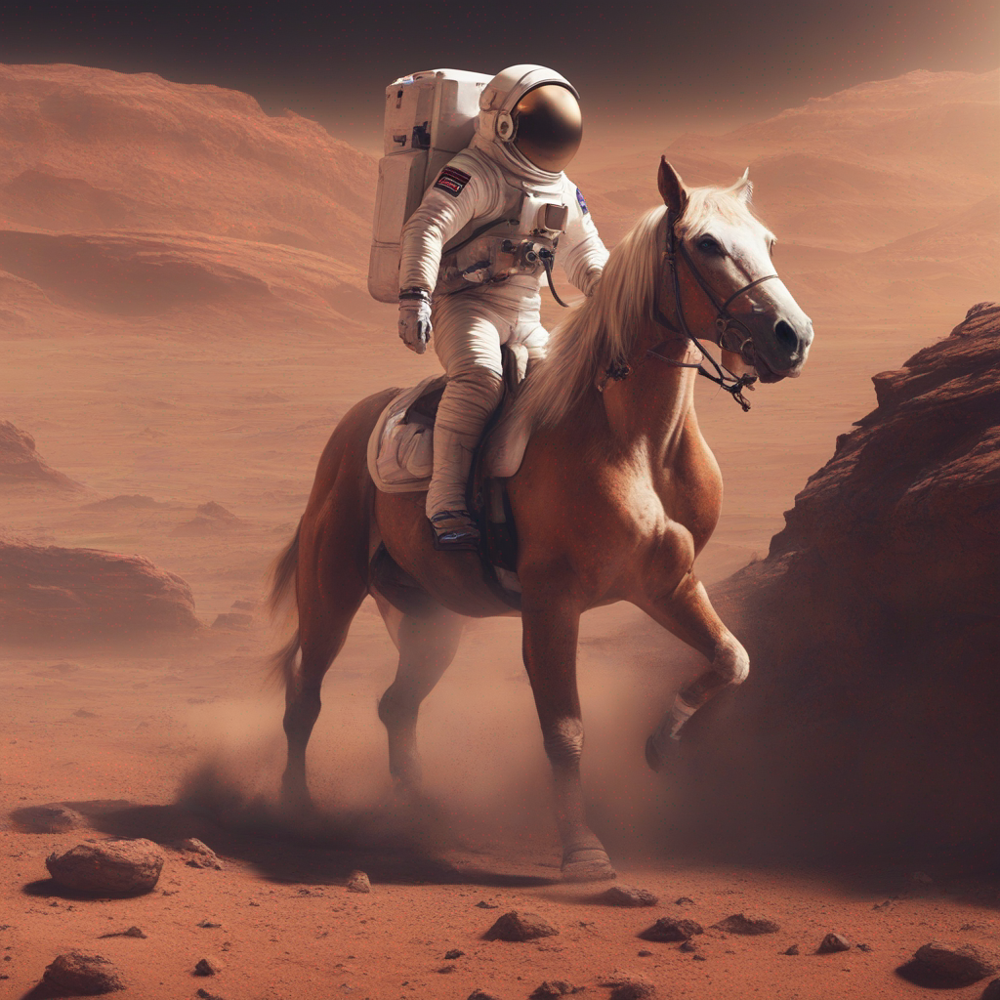

In [4]:
images[0]

In [ ]:
from diffusers.utils import make_image_grid 

images = pipe(
    prompt=prompt, 
    negative_prompt=negative_prompt,
    num_inference_steps=n_steps,
    num_images_per_prompt=4,
    # generator=torch.manual_seed(0)
).images

make_image_grid(images, 1, 4, resize=1024)

# ImgToImg

In [5]:
import torch
from diffusers import StableDiffusionXLImg2ImgPipeline
from diffusers.utils import load_image

pipe = StableDiffusionXLImg2ImgPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-refiner-1.0", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipe = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [6]:

url = "https://huggingface.co/datasets/patrickvonplaten/images/resolve/main/aa_xl/000000009.png"

init_image = load_image(url).convert("RGB")
prompt = "a photo of an astronaut riding a black horse at the beach"
image = pipe(prompt, image=init_image).images[0]

  0%|          | 0/15 [00:00<?, ?it/s]

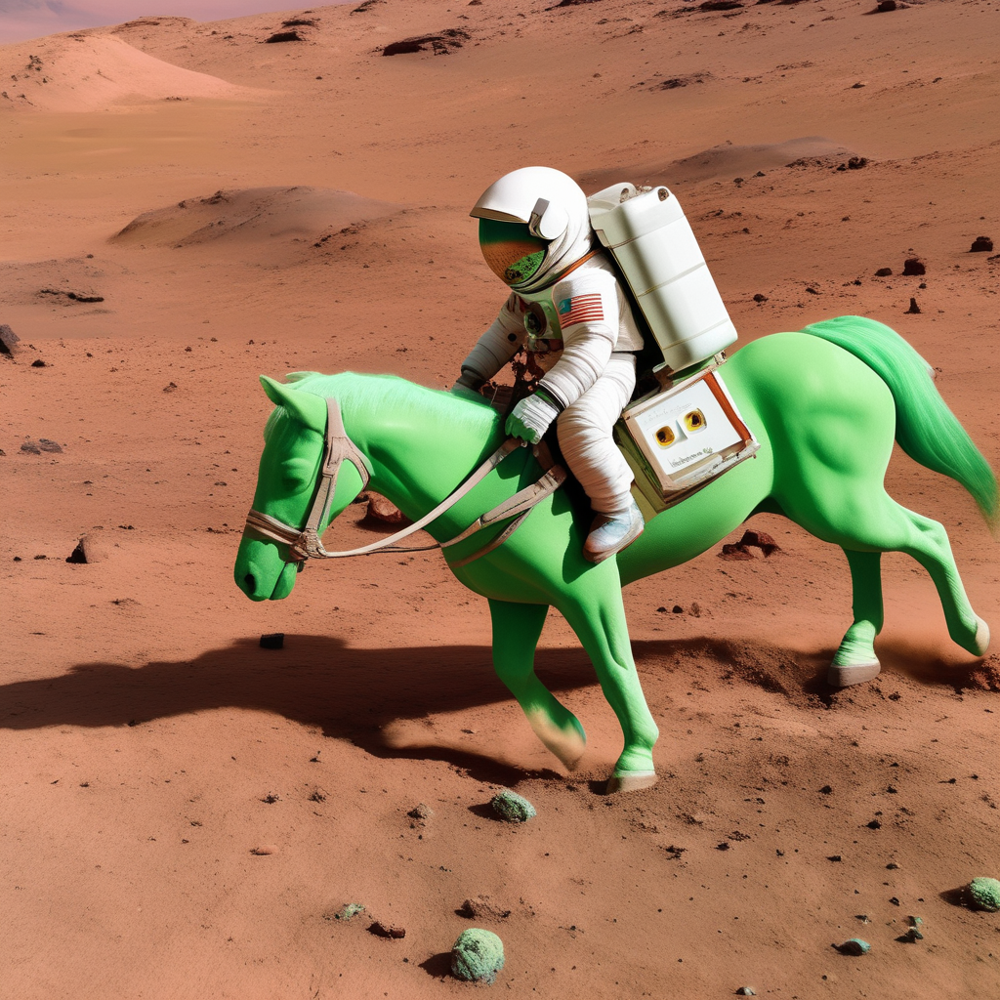

In [7]:
init_image

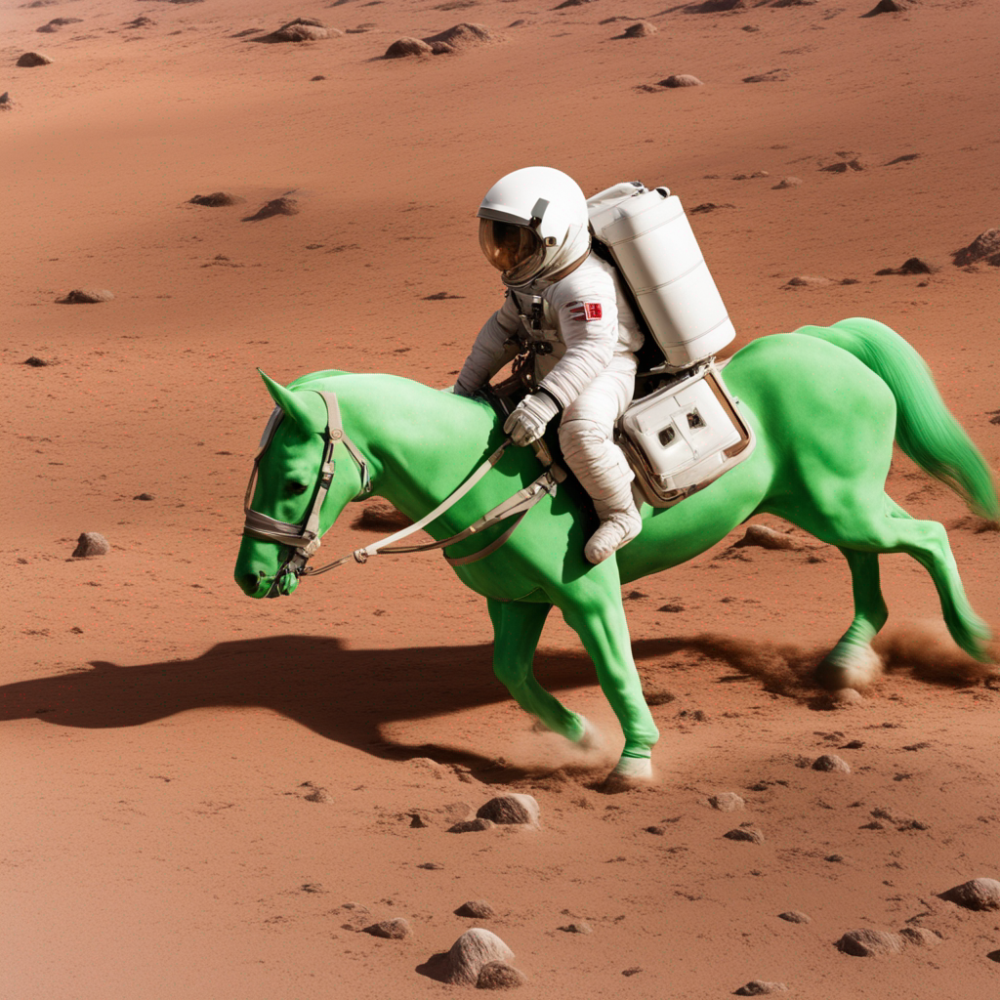

In [8]:
image

# Inpainting

In [1]:
import torch
from diffusers import StableDiffusionXLInpaintPipeline
from diffusers.utils import load_image

pipe = StableDiffusionXLInpaintPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, variant="fp16", use_safetensors=True
)
pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLInpaintPipeline {
  "_class_name": "StableDiffusionXLInpaintPipeline",
  "_diffusers_version": "0.21.0.dev0",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "force_zeros_for_empty_prompt": true,
  "requires_aesthetics_score": false,
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

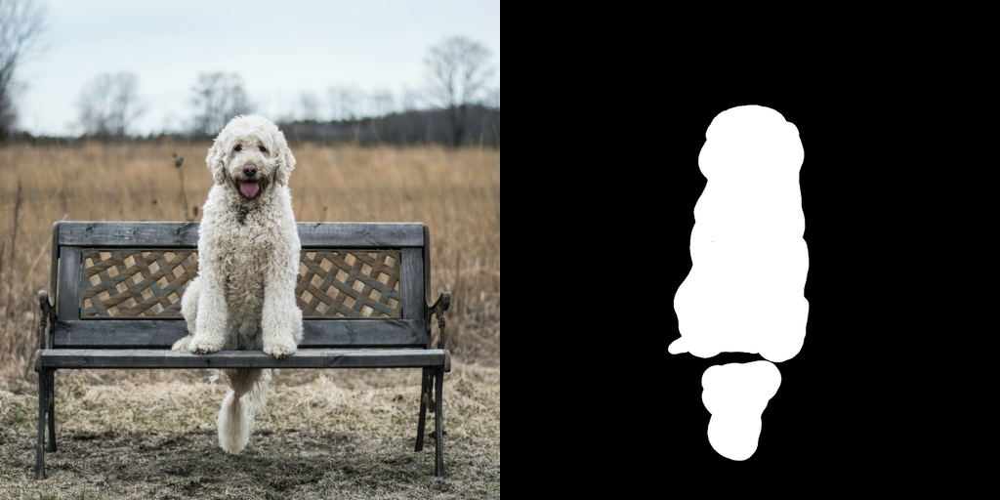

In [2]:
from diffusers.utils import make_image_grid 
import PIL
import requests
from io import BytesIO

def download_image(url):
    response = requests.get(url)
    return PIL.Image.open(BytesIO(response.content)).convert("RGB")

img_url = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/overture-creations-5sI6fQgYIuo.png"
mask_url = "https://raw.githubusercontent.com/CompVis/latent-diffusion/main/data/inpainting_examples/overture-creations-5sI6fQgYIuo_mask.png"

init_image = download_image(img_url).resize((512, 512))
mask_image = download_image(mask_url).resize((512, 512))


make_image_grid([init_image, mask_image], 1, 2)

In [3]:
prompt = "Face of a yellow cat, high resolution, sitting on a park bench"
negative_prompt = "blurry, out of focus"

In [10]:
image = pipe(
    prompt=prompt, 
    negative_prompt=negative_prompt, 
    image=init_image, 
    mask_image=mask_image, 
    num_inference_steps=20, 
    strength=0.80, 
    generator=torch.manual_seed(0)
).images[0]

  0%|          | 0/16 [00:00<?, ?it/s]

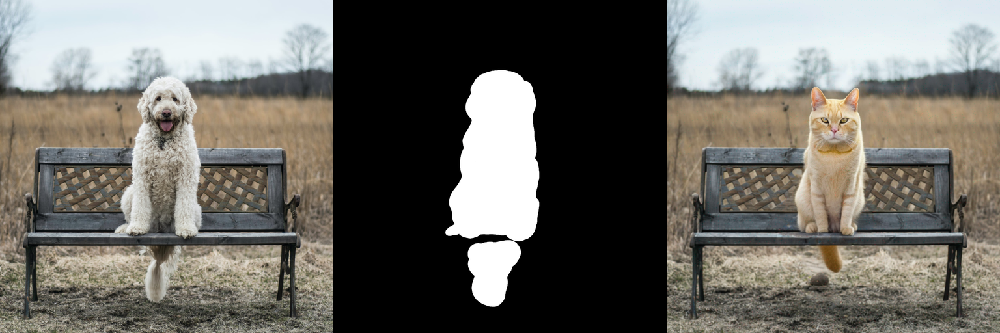

In [13]:
make_image_grid([init_image, mask_image, image], 1, 3, resize=512)

# Lora

In [1]:
from diffusers import StableDiffusionXLPipeline, AutoencoderKL, DiffusionPipeline
import torch

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae, torch_dtype=torch.float16, variant="fp16",
    use_safetensors=True
)
# pipe.load_lora_weights("goofyai/3d_render_style_xl", weight_name="3d_render_style_xl.safetensors")
# pipe.load_lora_weights("nerijs/pixel-art-xl", weight_name="pixel-art-xl.safetensors")
pipe.load_lora_weights("ostris/crayon_style_lora_sdxl", weight_name="crayons_v1_sdxl.safetensors")
# pipe.load_lora_weights("sayakpaul/lora-trained-xl-colab")
# pipe.load_lora_weights(".", weight_name="./my.safetensors")
_ = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

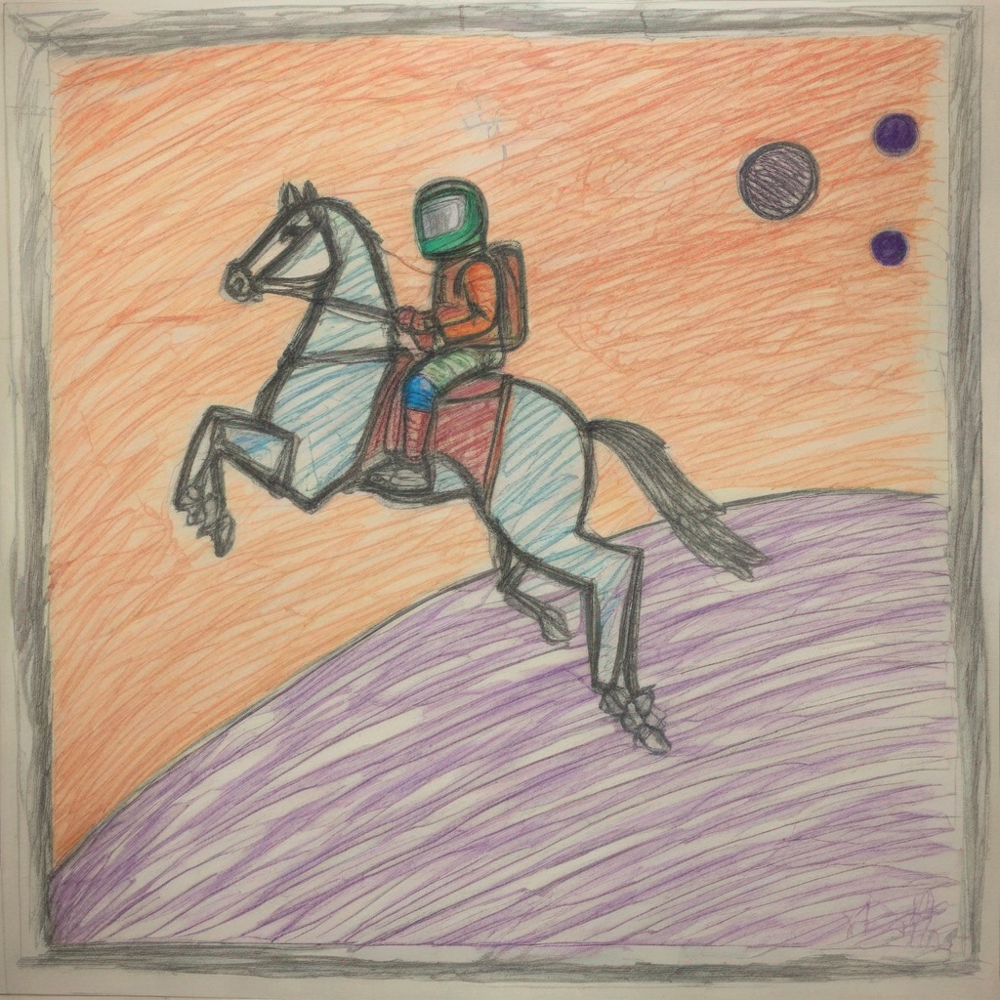

In [2]:
prompt = "An astronaut riding a horse on Mars"

image = pipe(
    prompt=prompt, 
    num_inference_steps=25).images[0]
image

In [3]:
prompt="An astronaut riding a horse on Mars"

In [4]:
images = pipe(prompt=prompt, 
    negative_prompt='', 
    num_inference_steps=20, 
    num_images_per_prompt=4,
    #generator=torch.manual_seed(0)
).images

  0%|          | 0/20 [00:00<?, ?it/s]

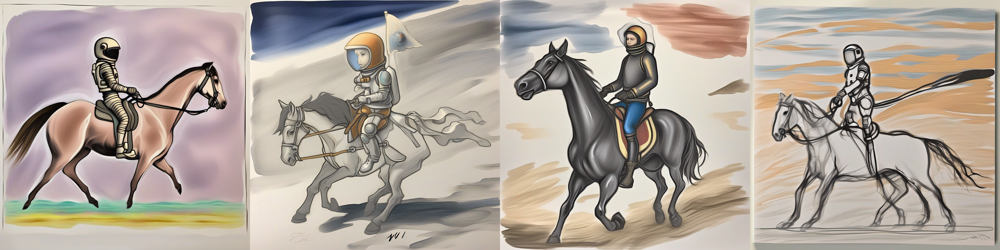

In [5]:
from diffusers.utils import make_image_grid 

make_image_grid(images, 1, 4)

## Incompatible lora

In [ ]:
!wget https://raw.githubusercontent.com/bmaltais/kohya_ss/master/networks/lora.py

In [ ]:
!wget https://huggingface.co//resolve/main/papercut.safetensors

In [ ]:
!wget https://civitai.com/api/download/models/138748 -O watercolorXL.safetensors

In [6]:
from diffusers import StableDiffusionXLPipeline, AutoencoderKL
import torch

pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [7]:
#@title Merge the LoRA with kohnya_ss `lora` class and hopefully see a papercut style image!

import lora

def merge_incompatible_lora(full_path_lora, lora_scale):
    for weights_file in [full_path_lora]:
        if ";" in weights_file:
            weights_file, multiplier = weights_file.split(";")
            multiplier = float(multiplier)
        else:
            multiplier = lora_scale

        lora_model, weights_sd = lora.create_network_from_weights(
            multiplier,
            full_path_lora,
            pipe.vae,
            pipe.text_encoder,
            pipe.unet,
            for_inference=True,
        )
        lora_model.merge_to(
            pipe.text_encoder, pipe.unet, weights_sd, torch.float16, "cuda"
        )

merge_incompatible_lora("papercut.safetensors", 1)

create LoRA network from weights
create LoRA for Text Encoder:
create LoRA for Text Encoder: 0 modules.
create LoRA for U-Net: 0 modules.
enable LoRA for U-Net
weights are merged


  0%|          | 0/20 [00:00<?, ?it/s]

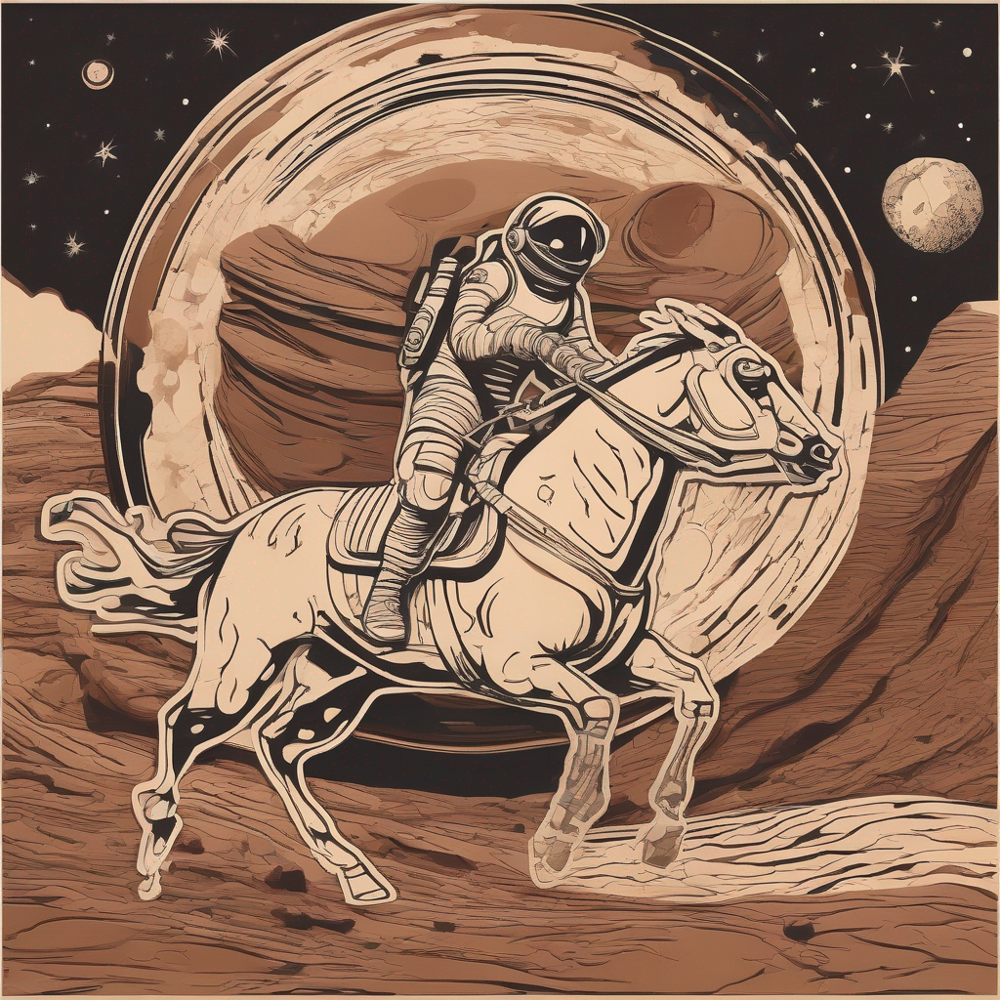

In [12]:
image = pipe(
    prompt="papercut of an astronaut riding a horse on Mars",
    negative_prompt='wrong',
    num_inference_steps=20,
    # guidance_scale=7.5,
    generator=torch.manual_seed(694654)
).images[0]

image

# ControlNet

In [13]:
import torch
from diffusers import (
    StableDiffusionXLControlNetPipeline,
    ControlNetModel,
    AutoencoderKL,
    UniPCMultistepScheduler,
)

controlnet = ControlNetModel.from_pretrained(
    "diffusers/controlnet-canny-sdxl-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
)
vae = AutoencoderKL.from_pretrained(
    "madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16, use_safetensors=True
)

model_path = "stabilityai/stable-diffusion-xl-base-1.0"
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    model_path, torch_dtype=torch.float16, controlnet=controlnet, vae=vae
)
pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLControlNetPipeline {
  "_class_name": "StableDiffusionXLControlNetPipeline",
  "_diffusers_version": "0.21.0.dev0",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "controlnet": [
    "diffusers",
    "ControlNetModel"
  ],
  "force_zeros_for_empty_prompt": true,
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [14]:
import cv2
from diffusers.utils import load_image, make_image_grid
import numpy as np
from PIL import Image

LOW_THRES = 100
HIGH_THRES = 200

image = load_image(
    "https://hf.co/datasets/huggingface/documentation-images/resolve/main/diffusers/input_image_vermeer.png"
)

def compute_canny(image_url):
    image = load_image(image_url)
    image = np.array(image)
    image = cv2.Canny(image, LOW_THRES, HIGH_THRES)
    image = image[:, :, None]
    image = np.concatenate([image, image, image], axis=2)
    canny_image = Image.fromarray(image)
    return canny_image.resize((1024, 1024))

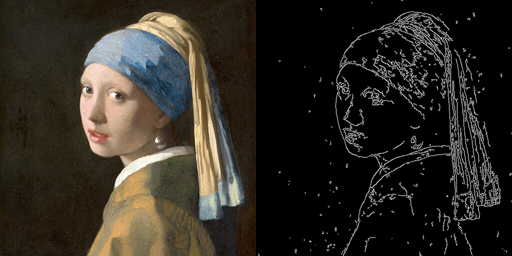

In [15]:
canny_image = compute_canny(
    image
)
make_image_grid([image, canny_image], 1, 2, resize=256)

In [12]:
prompt = "4k colored photo of a woman"
negative_prompt = ""

generator = torch.manual_seed(0)
images = pipe(
    prompt, 
    negative_prompt=negative_prompt, 
    image=canny_image,
    num_inference_steps=20, 
    # generator=generator,
    num_images_per_prompt=1, controlnet_conditioning_scale=0.5
).images

  0%|          | 0/20 [00:00<?, ?it/s]

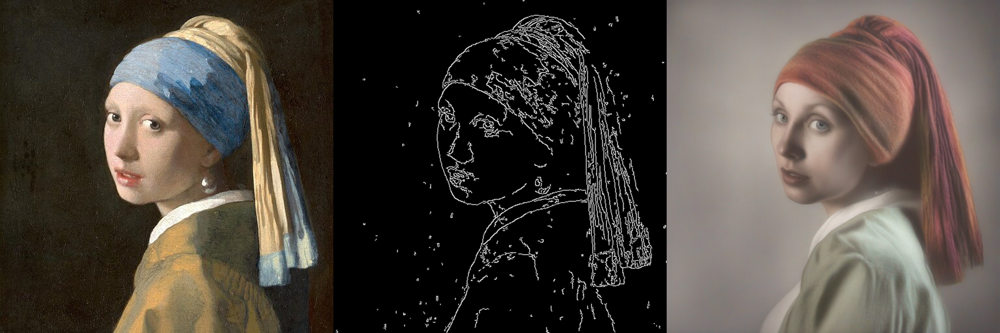

In [13]:
make_image_grid([image, canny_image] + images, 1, 3, resize=512)